In [1]:
import sys

sys.path.append('../../src')

In [10]:
sys.path.append('/ix/djishnu/alw399/SpaceOracle/src/Banksy_py')


In [1]:
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import umap
import seaborn as sns
import numpy as np


2025-04-06 00:52:47.600229: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI AVX512_BF16 AVX_VNNI AMX_TILE AMX_INT8 AMX_BF16 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-04-06 00:52:48.183218: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /ihome/crc/install/gcc-12.2.0/postgresql/15.2/lib:/ihome/crc/install/gcc-12.2.0/imagemagick/6.9.12/lib:/ihome/crc/install/gcc-12.2.0/geos/3.9.4/lib:/ihome/crc/install/gcc-12.2.0/zstd/zstd-1.5.5/lib:/ihome/crc/install/gcc-12.2.0/unixodbc/2.3.11/lib:/ihome/crc/install/sodium/1.0.18/lib:/ihome/crc/install/gcc-12.2.0/r/4.4.0/lib64/R/lib:/ihome/

In [3]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

To cross predict across samples, we can use the betadatas previously generated from another mouse kidney.
We want to align cells in our test set with cells with similar gene expression and positioned in a similar microenvironment.
Banksy embeddings for each cell is its gene expression concatenated with neighborhood gene expression.
Here, we align the embeddings of the test cells to the train cells, to see which betas each test cell should use.

### Get embeddings for test adata

In [3]:
from banksy_utils.load_data import load_adata, display_adata

In [8]:
adata = sc.read_h5ad('/ix/djishnu/shared/djishnu_kor11/training_data_2025/mouse_kidney_14.h5ad')
adata

AnnData object with n_obs × n_vars = 6102 × 3058
    obs: 'batch', 'rxn', 'n_counts', 'ct1', 'ct2', 'ct3', 'high_q', 'ct4', 'chip', 'exp', 'cond', 'samp-id', 'samp-type', 'cell_type', 'cell_type_int', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'
    obsm: 'spatial', 'spatial_unscaled'
    layers: 'imputed_count', 'normalized_count', 'raw_count'
    obsp: 'connectivities', 'distances'

In [10]:
# Banksy expects normalized count
adata.X = adata.layers['normalized_count']
del adata.layers['raw_count']
del adata.layers['imputed_count']

In [11]:
from banksy.main import median_dist_to_nearest_neighbour

In [12]:
plot_graph_weights = True
k_geom = 15 # number of spatial neighbours
max_m = 1 # use both mean and AFT
nbr_weight_decay = "scaled_gaussian" # can also choose "reciprocal", "uniform" or "ranked"

# Find median distance to closest neighbours
nbrs = median_dist_to_nearest_neighbour(adata, key = 'spatial')



Median distance to closest cell = 10.0

---- Ran median_dist_to_nearest_neighbour in 0.03 s ----



In [13]:
raw_x, raw_y = adata.obsm['spatial'][:, 0], adata.obsm['spatial'][:, 1]

adata.obs['x'] = raw_x
adata.obs['y'] = raw_y


Median distance to closest cell = 10.0

---- Ran median_dist_to_nearest_neighbour in 0.03 s ----

---- Ran generate_spatial_distance_graph in 0.07 s ----

---- Ran row_normalize in 0.01 s ----

---- Ran generate_spatial_weights_fixed_nbrs in 0.15 s ----

----- Plotting Edge Histograms for m = 0 -----

Edge weights (distances between cells): median = 19.166296949998213, mode = 15.329999412110594

---- Ran plot_edge_histogram in 0.03 s ----


Edge weights (weights between cells): median = 0.056975830903951516, mode = 0.028493467430523185

---- Ran plot_edge_histogram in 0.03 s ----

---- Ran generate_spatial_distance_graph in 0.10 s ----

---- Ran theta_from_spatial_graph in 0.03 s ----

---- Ran row_normalize in 0.01 s ----

---- Ran generate_spatial_weights_fixed_nbrs in 0.21 s ----

----- Plotting Edge Histograms for m = 1 -----

Edge weights (distances between cells): median = 26.04069726086876, mode = 25.570309325085333

---- Ran plot_edge_histogram in 0.17 s ----


Edge weights (w

/ix3/djishnu/alw399/envs/sheep/lib/python3.9/site-packages/matplotlib/cbook.py:1762: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
/ix3/djishnu/alw399/envs/sheep/lib/python3.9/site-packages/numpy/lib/histograms.py:841: ComplexWarning: Casting complex values to real discards the imaginary part
  indices = f_indices.astype(np.intp)
/ix3/djishnu/alw399/envs/sheep/lib/python3.9/site-packages/matplotlib/axes/_axes.py:7004: ComplexWarning: Casting complex values to real discards the imaginary part
  bins = np.array(bins, float)  # causes problems if float16
/ix3/djishnu/alw399/envs/sheep/lib/python3.9/site-packages/matplotlib/cbook.py:1398: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


---- Ran plot_graph_weights in 0.50 s ----

Maximum weight: (0.08924172777608569+0j)

---- Ran plot_graph_weights in 1.32 s ----

----- Plotting theta Graph -----


/ix3/djishnu/alw399/envs/sheep/lib/python3.9/site-packages/matplotlib/collections.py:426: ComplexWarning: Casting complex values to real discards the imaginary part
  renderer.draw_path_collection(


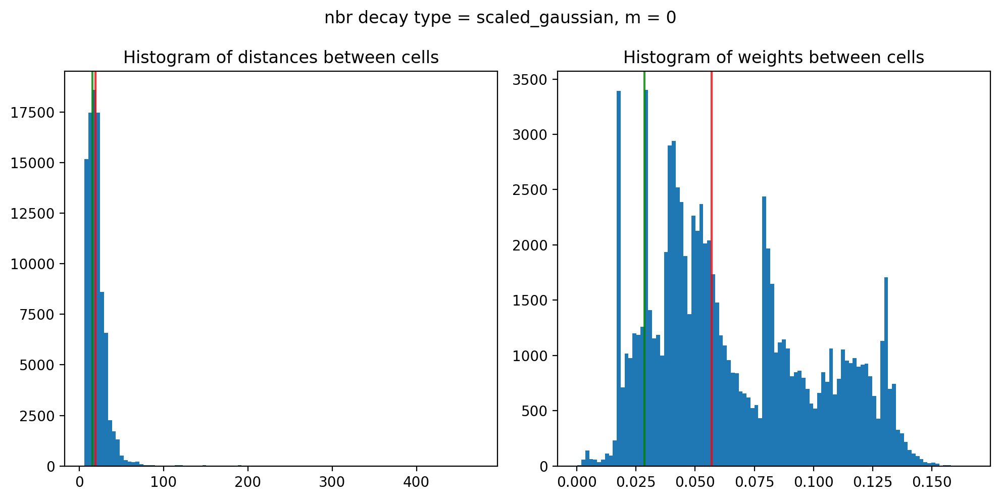

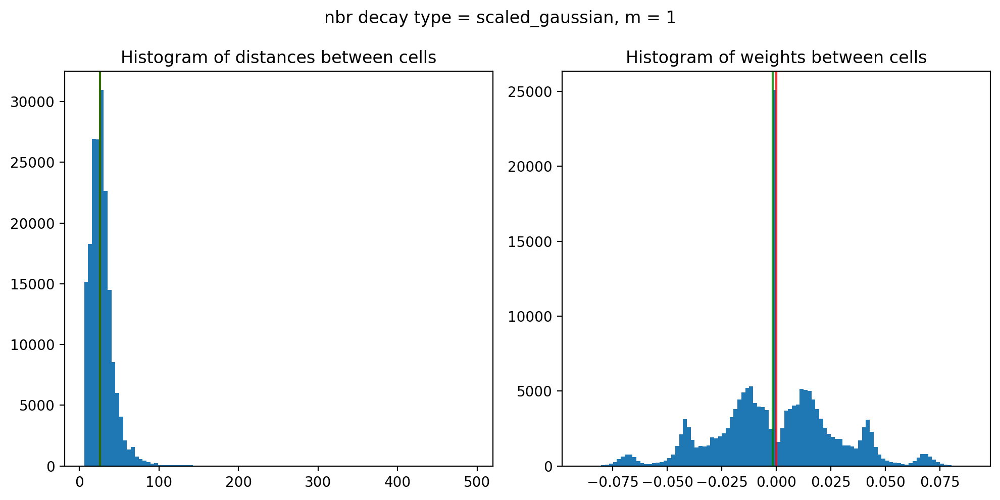

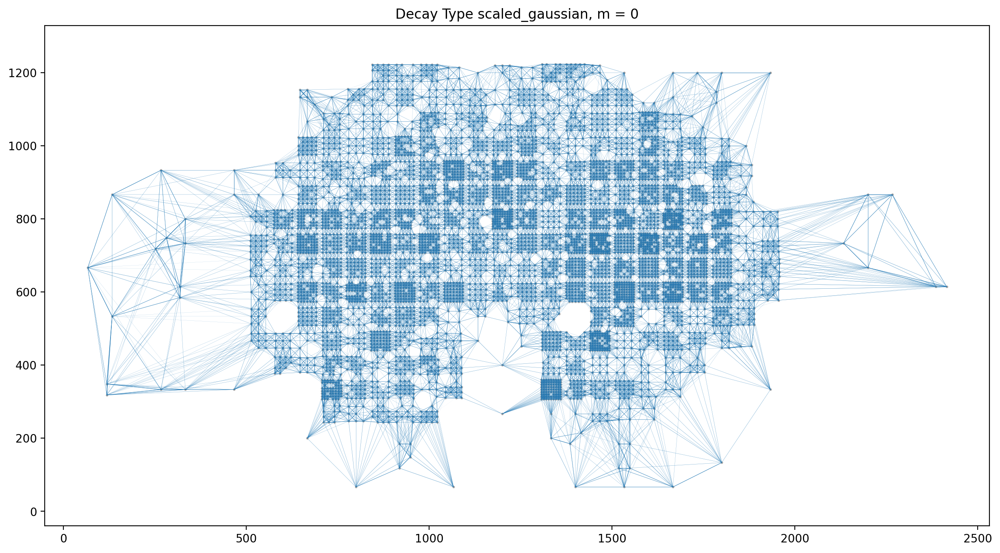

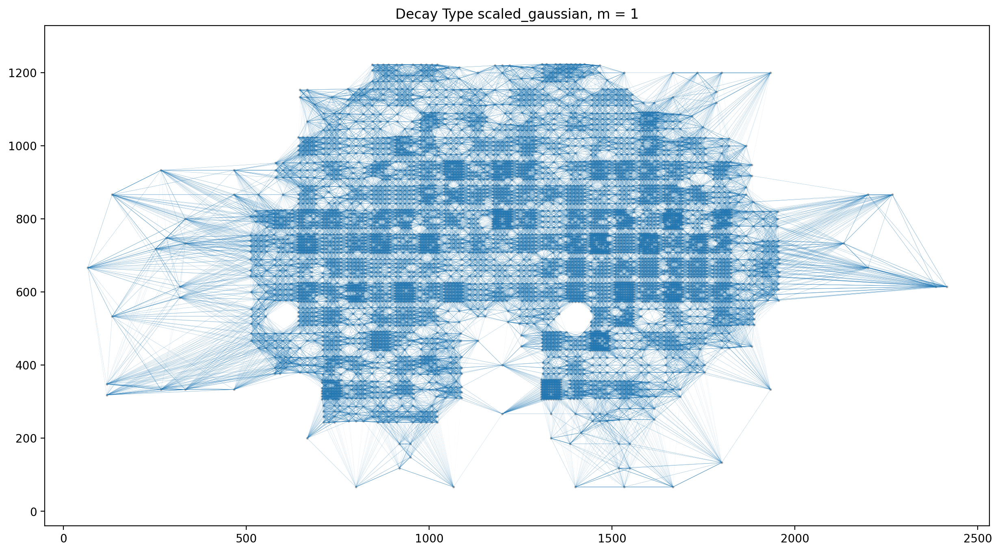

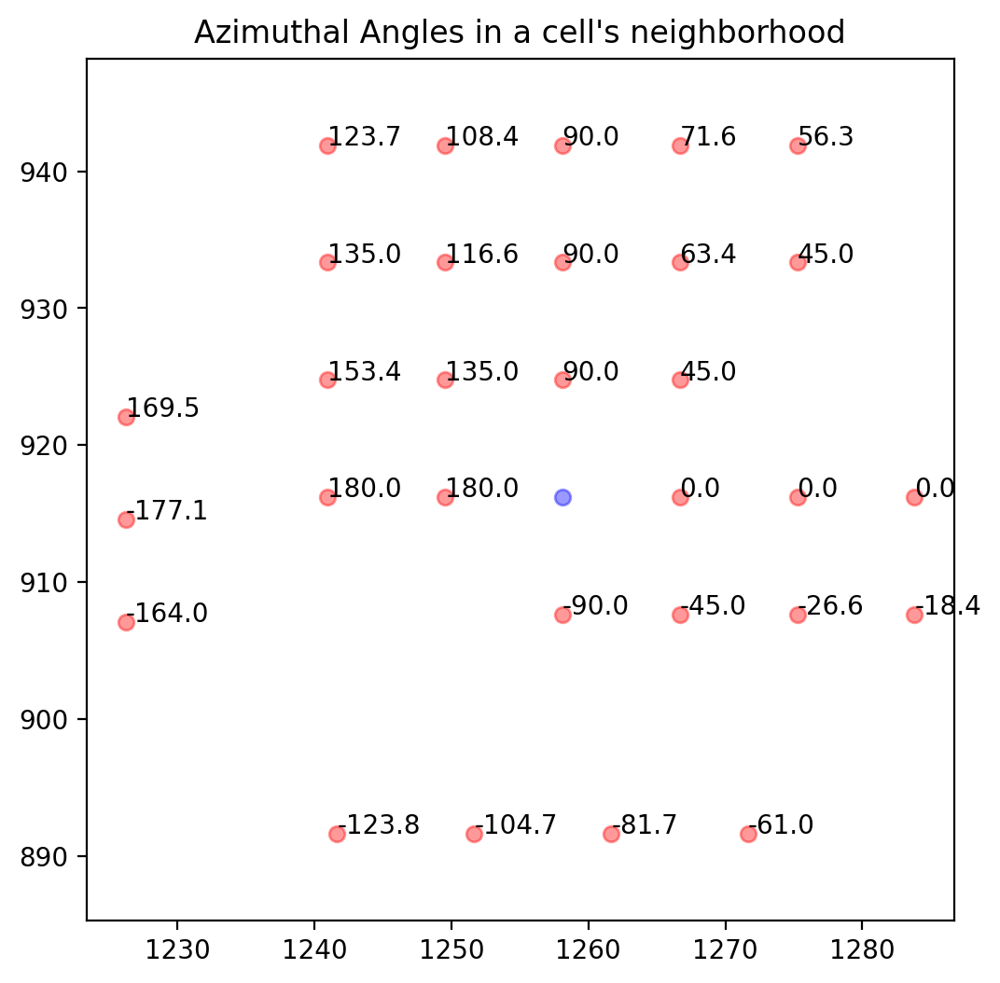

In [14]:
from banksy.initialize_banksy import initialize_banksy

banksy_dict = initialize_banksy(
    adata,
    ('x', 'y', 'spatial'),
    k_geom,
    nbr_weight_decay=nbr_weight_decay,
    max_m=max_m,
    plt_edge_hist=True,
    plt_nbr_weights=True,
    plt_agf_angles=False, # takes long time to plot
    plt_theta=True,
)

In [15]:
from banksy.embed_banksy import generate_banksy_matrix

# The following are the main hyperparameters for BANKSY
# -----------------------------------------------------
resolutions = [1.0]  # clustering resolution for UMAP
pca_dims = [50]  # Dimensionality in which PCA reduces to
lambda_list = [0.2]  # list of lambda parameters

banksy_dict, banksy_matrix = generate_banksy_matrix(adata,
                                                    banksy_dict,
                                                    lambda_list,
                                                    max_m)
banksy_matrix

Runtime Mar-25-2025-16-56

3058 genes to be analysed:
Gene List:
Index(['Sox17', 'St18', 'Prex2', 'Lactb2', 'Kcnb2', 'Stau2', 'Pi15',
       'Crispld1', 'Tfap2b', 'Pkhd1',
       ...
       'Gpm6b', 'Ofd1', 'Egfl6', 'Tmsb4x', 'Tlr8', 'Tlr7', 'Frmpd4', 'Arhgap6',
       'Amelx', 'Mid1'],
      dtype='object', length=3058)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <6102x6102 sparse matrix of type '<class 'numpy.float64'>'
	with 91530 stored elements in Compressed Sparse Row format>, 1: <6102x6102 sparse matrix of type '<class 'numpy.complex128'>'
	with 183060 stored elements in Compressed Sparse Row format>}}

Nbr matrix | Mean: 0.09 | Std: 0.22
Size of Nbr | Shape: (6102, 3058)
Top 3 entries of Nbr Mat:

[[0.02043119 0.         0.18603325]
 [0.20916443 0.05006157 0.05834494]
 [0.04797791 0.         0.06054138]]

AGF matrix | Mean: 0.04 | Std: 0.05
Size of AGF mat (m = 1) | Shape: (6102, 3058)
Top entries of AGF:
[[0.02584891 0.01852576 0.0539494 ]
 [0.13578769 0.03036

/ix/djishnu/alw399/SpaceOracle/src/Banksy_py/banksy/main.py:302: RuntimeWarning: invalid value encountered in divide
  zscored_matrix = (matrix - E_x) / np.sqrt(variance)


Shape of BANKSY matrix: (6102, 9174)
Type of banksy_matrix: <class 'anndata._core.anndata.AnnData'>



AnnData object with n_obs × n_vars = 6102 × 9174
    obs: 'batch', 'rxn', 'n_counts', 'ct1', 'ct2', 'ct3', 'high_q', 'ct4', 'chip', 'exp', 'cond', 'samp-id', 'samp-type', 'cell_type', 'cell_type_int', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'x', 'y'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'is_nbr', 'k'

In [17]:
adata, banksy_matrix

(AnnData object with n_obs × n_vars = 6102 × 3058
     obs: 'batch', 'rxn', 'n_counts', 'ct1', 'ct2', 'ct3', 'high_q', 'ct4', 'chip', 'exp', 'cond', 'samp-id', 'samp-type', 'cell_type', 'cell_type_int', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'x', 'y'
     var: 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
     uns: 'log1p'
     obsm: 'spatial', 'spatial_unscaled'
     layers: 'normalized_count'
     obsp: 'connectivities', 'distances',
 AnnData object with n_obs × n_vars = 6102 × 9174
     obs: 'batch', 'rxn', 'n_counts', 'ct1', 'ct2', 'ct3', 'high_q', 'ct4', 'chip', 'exp', 'cond', 'samp-id', 'samp-type', 'cell_type', 'cell_type_int', 'n_genes_by_counts', 'log1p_n_genes_by_counts',

In [18]:
banksy_matrix.var_names

Index(['Sox17', 'St18', 'Prex2', 'Lactb2', 'Kcnb2', 'Stau2', 'Pi15',
       'Crispld1', 'Tfap2b', 'Pkhd1',
       ...
       'Gpm6b_nbr_1', 'Ofd1_nbr_1', 'Egfl6_nbr_1', 'Tmsb4x_nbr_1',
       'Tlr8_nbr_1', 'Tlr7_nbr_1', 'Frmpd4_nbr_1', 'Arhgap6_nbr_1',
       'Amelx_nbr_1', 'Mid1_nbr_1'],
      dtype='object', length=9174)

In [24]:
import numpy as np

df = banksy_matrix.to_df().values
np.min(df), np.max(df)

(-4.354429244995117, 69.86271667480469)

In [ ]:
# Save the BANKSY matrix embeddings
# ---------------------------------

banksy_dir = '/ix/djishnu/shared/djishnu_kor11/banksy_outputs'
banksy_matrix.to_df().to_parquet(f'{banksy_dir}/mouse_kidney_14_embedding.parquet')

In [ ]:
from banksy_utils.umap_pca import pca_umap

pca_umap(banksy_dict,
         pca_dims = pca_dims,
         add_umap = True,
         plt_remaining_var = False,
         )

In [ ]:
from banksy.cluster_methods import run_Leiden_partition

results_df, max_num_labels = run_Leiden_partition(
    banksy_dict,
    resolutions,
    num_nn = 50, # k_expr: number of neighbours in expression (BANKSY embedding or non-spatial) space
    num_iterations = -1, # run to convergenece
    partition_seed = 42,
    match_labels = True,
)

In [ ]:
from banksy.plot_banksy import plot_results

c_map =  'tab20' # specify color map
weights_graph =  banksy_dict['scaled_gaussian']['weights'][0]

plot_results(
    results_df,
    weights_graph,
    c_map,
    match_labels = True,
    coord_keys = ('x', 'y', 'spatial'),
    max_num_labels  =  max_num_labels, 
    save_path = '/tmp',
    save_fig = False
)

### Get embeddings from reference

In [12]:
adata_train = sc.read_h5ad('/ix/djishnu/shared/djishnu_kor11/training_data_2025/mouse_kidney_13.h5ad')
adata_train

AnnData object with n_obs × n_vars = 8509 × 3058
    obs: 'ct1', 'ct2', 'ct3', 'ct4', 'cond', 'medulla_cortex', 'domain', 'cell_type', 'cell_type_int'
    uns: 'cell_thresholds', 'cell_type_colors', 'neighbors', 'pca', 'received_ligands', 'received_ligands_tfl', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'spatial_unscaled'
    varm: 'PCs'
    layers: 'imputed_count', 'normalized_count', 'raw_count'
    obsp: 'connectivities', 'distances'

In [13]:
# Banksy expects normalized count
adata_train.X = adata_train.layers['normalized_count']
del adata_train.layers['raw_count']
del adata_train.layers['imputed_count']

In [14]:
from banksy.main import median_dist_to_nearest_neighbour

plot_graph_weights = True
k_geom = 15 # number of spatial neighbours
max_m = 1 # use both mean and AFT
nbr_weight_decay = "scaled_gaussian" # can also choose "reciprocal", "uniform" or "ranked"

# Find median distance to closest neighbours
nbrs = median_dist_to_nearest_neighbour(adata_train, key = 'spatial')



Median distance to closest cell = 10.0

---- Ran median_dist_to_nearest_neighbour in 0.03 s ----




Median distance to closest cell = 10.0

---- Ran median_dist_to_nearest_neighbour in 0.03 s ----

---- Ran generate_spatial_distance_graph in 0.07 s ----

---- Ran row_normalize in 0.02 s ----

---- Ran generate_spatial_weights_fixed_nbrs in 0.17 s ----

----- Plotting Edge Histograms for m = 0 -----

Edge weights (distances between cells): median = 19.565594803123464, mode = 19.829227800515174

---- Ran plot_edge_histogram in 0.03 s ----


Edge weights (weights between cells): median = 0.05672889861803235, mode = 0.03820283940351443

---- Ran plot_edge_histogram in 0.03 s ----

---- Ran generate_spatial_distance_graph in 0.10 s ----

---- Ran theta_from_spatial_graph in 0.04 s ----

---- Ran row_normalize in 0.02 s ----

---- Ran generate_spatial_weights_fixed_nbrs in 0.25 s ----

----- Plotting Edge Histograms for m = 1 -----

Edge weights (distances between cells): median = 26.25000000000057, mode = 24.974317988793167

---- Ran plot_edge_histogram in 0.03 s ----


Edge weights (wei

/ix3/djishnu/alw399/envs/sheep/lib/python3.9/site-packages/matplotlib/cbook.py:1762: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
/ix3/djishnu/alw399/envs/sheep/lib/python3.9/site-packages/numpy/lib/histograms.py:841: ComplexWarning: Casting complex values to real discards the imaginary part
  indices = f_indices.astype(np.intp)
/ix3/djishnu/alw399/envs/sheep/lib/python3.9/site-packages/matplotlib/axes/_axes.py:7004: ComplexWarning: Casting complex values to real discards the imaginary part
  bins = np.array(bins, float)  # causes problems if float16
/ix3/djishnu/alw399/envs/sheep/lib/python3.9/site-packages/matplotlib/cbook.py:1398: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


Maximum weight: 0.16494463116900848

---- Ran plot_graph_weights in 0.81 s ----

Maximum weight: (0.08535049653907315+0j)

---- Ran plot_graph_weights in 1.68 s ----

----- Plotting theta Graph -----


/ix3/djishnu/alw399/envs/sheep/lib/python3.9/site-packages/matplotlib/collections.py:426: ComplexWarning: Casting complex values to real discards the imaginary part
  renderer.draw_path_collection(


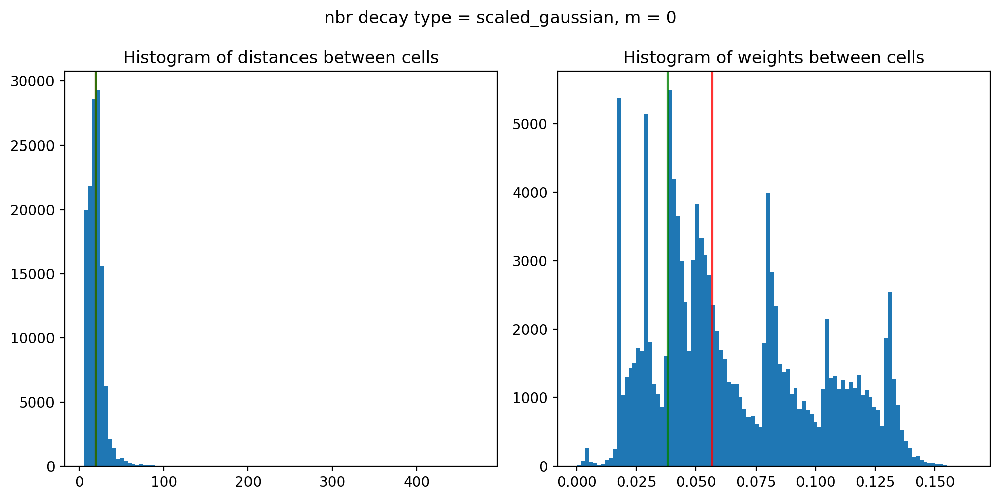

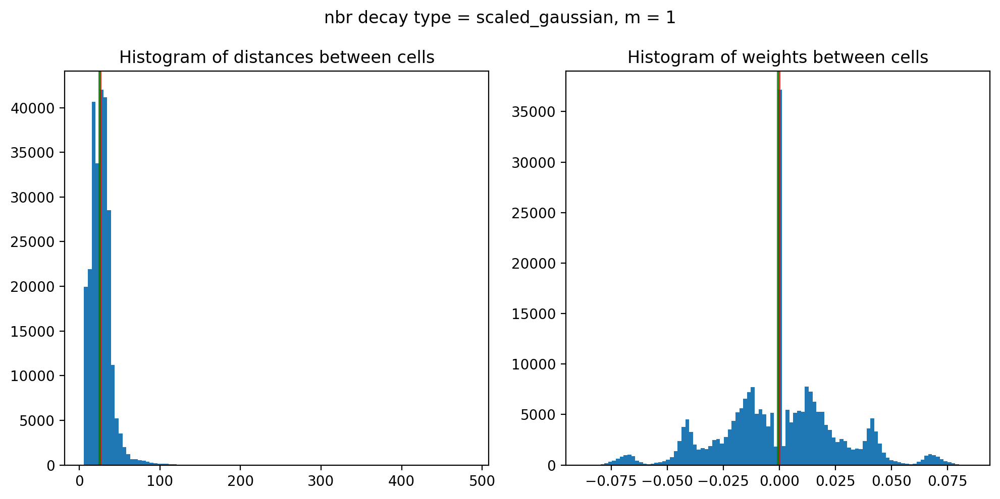

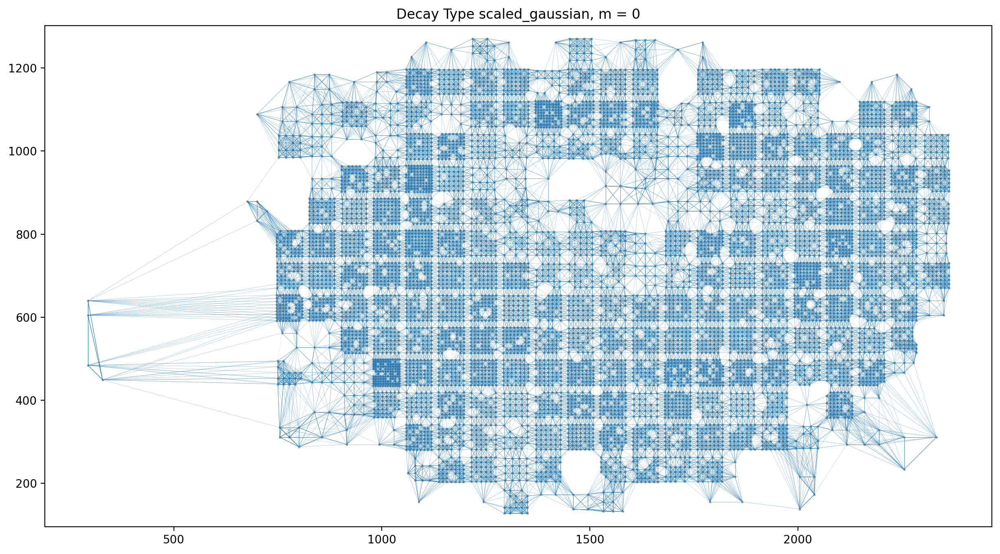

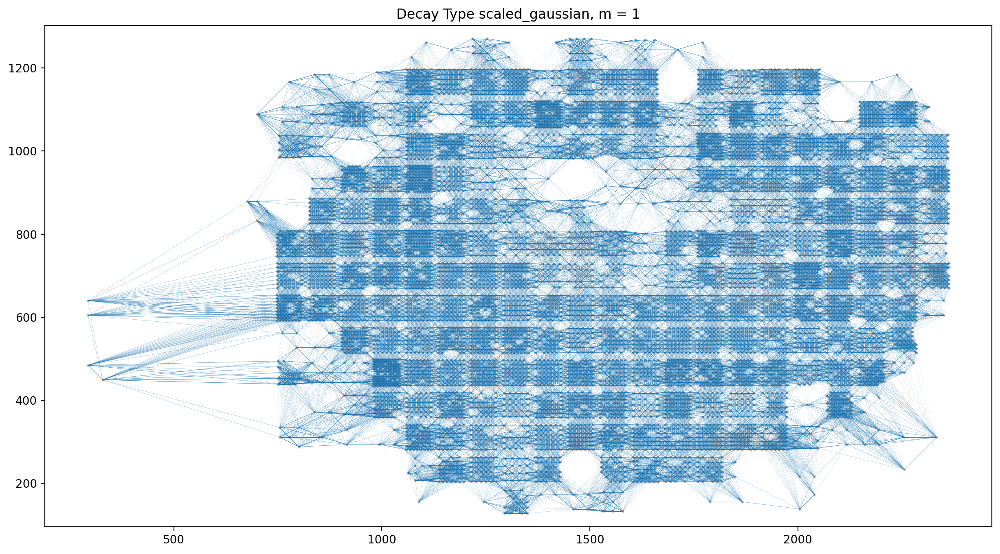

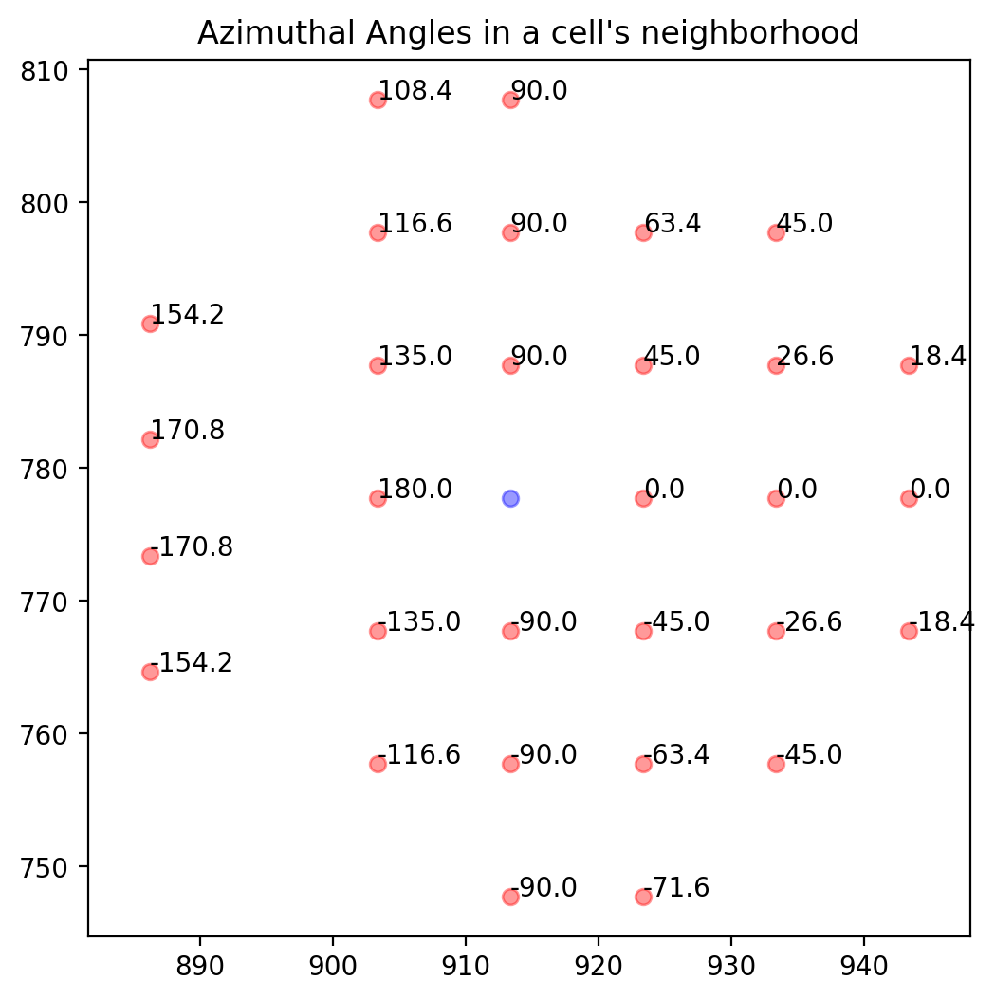

In [15]:
from banksy.initialize_banksy import initialize_banksy

banksy_dict = initialize_banksy(
    adata_train,
    ('x', 'y', 'spatial'),
    k_geom,
    nbr_weight_decay=nbr_weight_decay,
    max_m=max_m,
    plt_edge_hist=True,
    plt_nbr_weights=True,
    plt_agf_angles=False, # takes long time to plot
    plt_theta=True,
)

In [16]:
from banksy.embed_banksy import generate_banksy_matrix

# The following are the main hyperparameters for BANKSY
# -----------------------------------------------------
resolutions = [1.0]  # clustering resolution for UMAP
pca_dims = [50]  # Dimensionality in which PCA reduces to
lambda_list = [0.2]  # list of lambda parameters

banksy_dict, banksy_matrix = generate_banksy_matrix(adata_train,
                                                    banksy_dict,
                                                    lambda_list,
                                                    max_m)
banksy_matrix

Runtime Mar-25-2025-17-05

3058 genes to be analysed:
Gene List:
Index(['Sox17', 'St18', 'Prex2', 'Lactb2', 'Kcnb2', 'Stau2', 'Pi15',
       'Crispld1', 'Tfap2b', 'Pkhd1',
       ...
       'Gpm6b', 'Ofd1', 'Egfl6', 'Tmsb4x', 'Tlr8', 'Tlr7', 'Frmpd4', 'Arhgap6',
       'Amelx', 'Mid1'],
      dtype='object', length=3058)

Decay Type: scaled_gaussian
Weights Object: {'weights': {0: <8509x8509 sparse matrix of type '<class 'numpy.float64'>'
	with 127635 stored elements in Compressed Sparse Row format>, 1: <8509x8509 sparse matrix of type '<class 'numpy.complex128'>'
	with 255270 stored elements in Compressed Sparse Row format>}}

Nbr matrix | Mean: 0.13 | Std: 0.26
Size of Nbr | Shape: (8509, 3058)
Top 3 entries of Nbr Mat:

[[0.         0.         0.10953716]
 [0.         0.02424211 0.72928694]
 [0.56372844 0.05041618 0.75917201]]

AGF matrix | Mean: 0.04 | Std: 0.06
Size of AGF mat (m = 1) | Shape: (8509, 3058)
Top entries of AGF:
[[0.00100391 0.         0.12643102]
 [0.         0.0117

AnnData object with n_obs × n_vars = 8509 × 9174
    obs: 'ct1', 'ct2', 'ct3', 'ct4', 'cond', 'medulla_cortex', 'domain', 'cell_type', 'cell_type_int'
    var: 'is_nbr', 'k'

In [17]:
import numpy as np 

df = banksy_matrix.to_df().values
np.min(df), np.max(df)

(-6.766073226928711, 55.80235290527344)

In [18]:
# Save the BANKSY matrix embeddings
# ---------------------------------

banksy_dir = '/ix/djishnu/shared/djishnu_kor11/banksy_outputs'
banksy_matrix.to_df().to_parquet(f'{banksy_dir}/mouse_kidney_13_embedding.parquet')

### Match embeddings

In [ ]:
ref_adata = sc.read_h5ad('/ix/djishnu/shared/djishnu_kor11/training_data_2025/mouse_kidney_13.h5ad')
test_adata = sc.read_h5ad('/ix/djishnu/shared/djishnu_kor11/training_data_2025/mouse_kidney_14.h5ad')

In [6]:
banksy_dir = '/ix/djishnu/shared/djishnu_kor11/banksy_outputs'
ref_embed = pd.read_parquet(f'{banksy_dir}/mouse_kidney_13_embedding.parquet')
test_embed = pd.read_parquet(f'{banksy_dir}/mouse_kidney_14_embedding.parquet')

ref_embed.shape, test_embed.shape

((8509, 9174), (6102, 9174))

In [7]:
test_embed = test_embed.reindex(ref_embed.columns, axis=1)
test_embed.head(3)

,Sox17,St18,Prex2,Lactb2,Kcnb2,Stau2,Pi15,Crispld1,Tfap2b,Pkhd1,...,Gpm6b_nbr_1,Ofd1_nbr_1,Egfl6_nbr_1,Tmsb4x_nbr_1,Tlr8_nbr_1,Tlr7_nbr_1,Frmpd4_nbr_1,Arhgap6_nbr_1,Amelx_nbr_1,Mid1_nbr_1
AAACCCAAGCCATTCA-1,-0.167402,-0.132242,-0.228439,-0.26631,-0.011451,-0.317972,-0.019837,-0.126119,-0.148371,-0.200656,...,-0.114182,0.540682,-0.138974,0.276008,-0.161887,0.280469,-0.054032,-0.352306,-0.067644,-0.254842
AAACCCACAAATCAGA-1,-0.167402,-0.132242,-0.228439,-0.26631,-0.011451,-0.317972,-0.019837,-0.126119,6.924605,3.781619,...,0.193521,-0.166630,-0.138974,0.287608,-0.161887,-0.111559,-0.142609,-0.209568,-0.067644,0.261792
AAACCCACAACTCATG-1,-0.167402,-0.132242,-0.228439,-0.26631,-0.011451,1.764662,-0.019837,-0.126119,-0.148371,3.781619,...,-0.114182,0.036885,-0.138974,0.124164,-0.161887,0.683315,-0.142609,0.042527,-0.067644,0.055853


In [55]:
test_embed.shape, ref_embed.shape

((6102, 9174), (8509, 9174))

In [103]:
from sklearn.metrics.pairwise import cosine_similarity

def match_cells(test_embed, ref_embed):
    cos_sim_matrix = cosine_similarity(test_embed, ref_embed)
    closest_indices = np.argmax(cos_sim_matrix, axis=1)
    matched_refs = ref_embed.iloc[closest_indices]
    matched = matched_refs.index
    return matched

celltypes = test_adata.obs['cell_type'].unique()

test_cts = {ct: test_adata.obs['cell_type'] == ct for ct in celltypes}
ref_cts = {ct: ref_adata.obs['cell_type'] == ct for ct in celltypes}
test_cells = test_adata.obs.index

matched = pd.DataFrame(index=test_cells , columns=['reference_cell'])
for ct, ct_mask in test_cts.items():
    matched.loc[test_cells[ct_mask], 'reference_cell'] = match_cells(test_embed.loc[ct_mask], ref_embed[ref_cts[ct]]).values
    test_adata.obs.loc[ct_mask, 'reference_cell'] = matched

In [107]:
matched['reference_cell'].value_counts()

reference_cell
CATAGACTCTACGGTA-13    120
TTGCCTGCATAATCCG-13     48
GTTGTCCTCGAAACAA-13     43
CAGCGTGCATTGCAAC-13     39
CGTTCTGCAATCTCTT-13     38
                      ... 
TAATCTCCACCAAATC-13      1
TTCACCGAGGTAGATT-13      1
CAGCACGTCGTGGCGT-13      1
GCTGGGTTCTTGGAAC-13      1
ACTCTCGGTTGTCTAG-13      1
Name: count, Length: 2431, dtype: int64

### Mapping with PCA/ UMAP

In [47]:
from sklearn.decomposition import PCA
import numpy as np

pca = PCA(n_components=100)
pca.fit(pd.concat([ref_embed, test_embed], axis=0).values)

ref_embed_pca = pca.transform(ref_embed.values)
test_embed_pca = pca.transform(test_embed.values)


Text(0, 0.5, 'Cumulative Explained Variance')

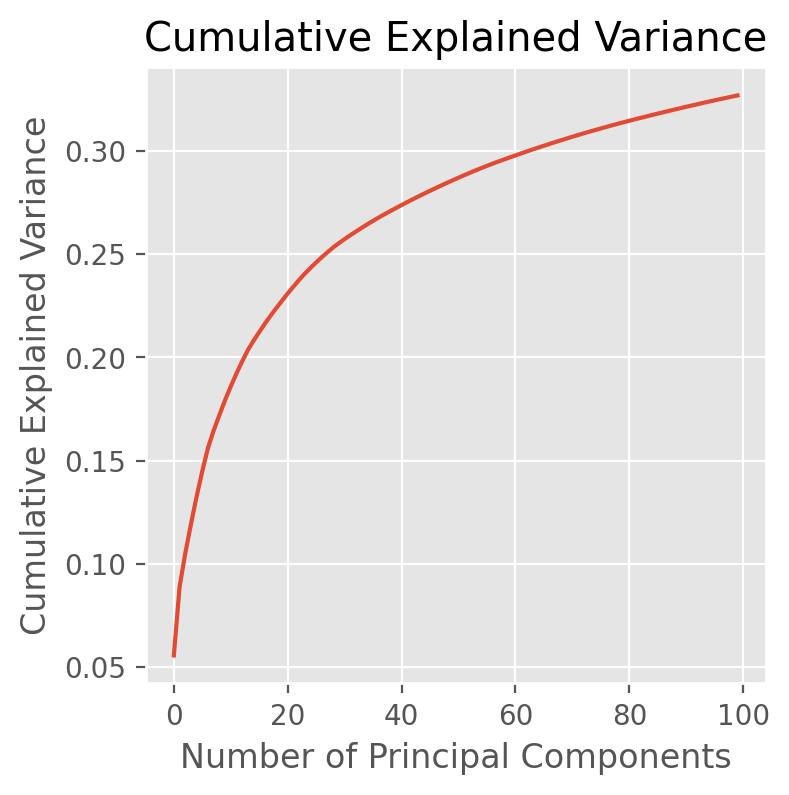

In [48]:
plt.figure(figsize=(4, 4))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.title('Cumulative Explained Variance')
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance')

In [49]:
umap_ref = umap.UMAP(low_memory=True).fit_transform(ref_embed_pca)
umap_test = umap.UMAP(low_memory=True).fit_transform(test_embed_pca)

/tmp/ipykernel_28047/3701730896.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cell_type_colors = plt.cm.get_cmap('tab10', len(ref_adata.obs['cell_type'].cat.categories))


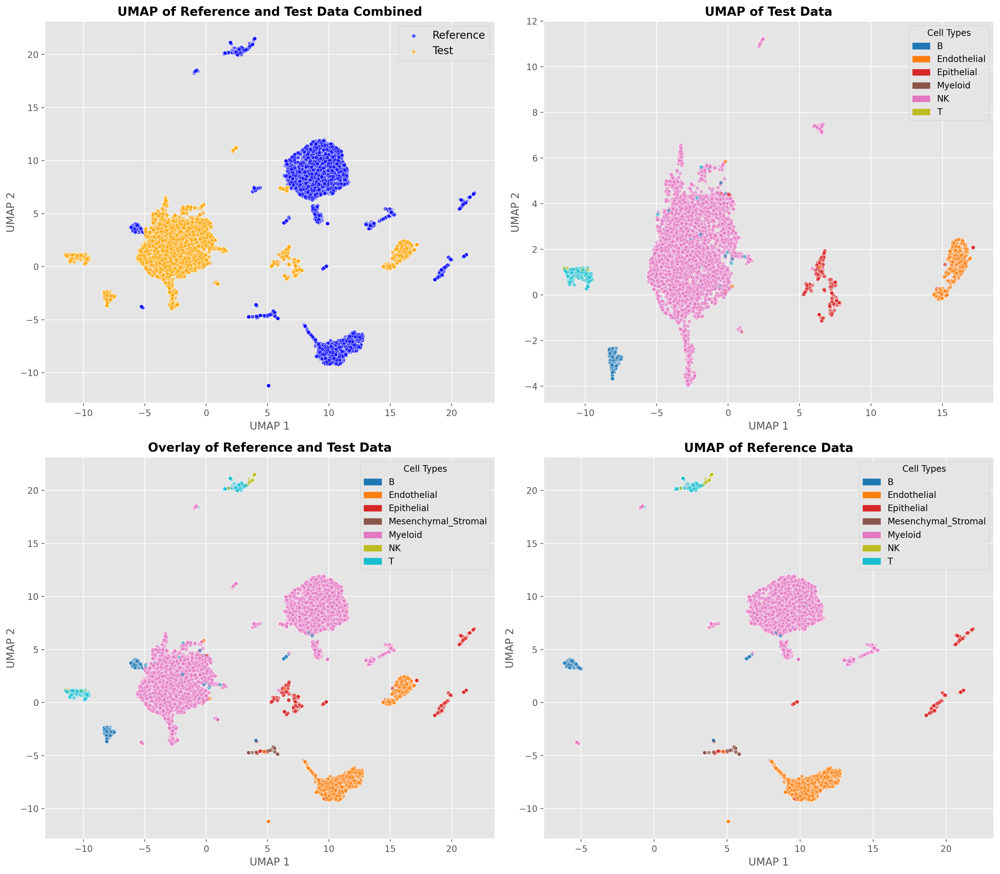

In [51]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from matplotlib import patches

# Ensure that the 'cell_type' column is categorical
ref_adata.obs['cell_type'] = ref_adata.obs['cell_type'].astype('category')
test_adata.obs['cell_type'] = test_adata.obs['cell_type'].astype('category')

# Create numeric encodings for the cell types
ref_adata.obs['cell_type_int'] = pd.Categorical(ref_adata.obs['cell_type']).codes
test_adata.obs['cell_type_int'] = pd.Categorical(test_adata.obs['cell_type']).codes

# Define a color map for the cell types
cell_type_colors = plt.cm.get_cmap('tab10', len(ref_adata.obs['cell_type'].cat.categories))

# Create a 2x2 subplot layout with improved aesthetics
fig, axes = plt.subplots(2, 2, figsize=(16, 14))  # Adjust the size to fit the subplots
plt.style.use('ggplot')

# Plot 1: UMAP of Reference and Test Data combined (colored by dataset)
axes[0, 0].scatter(umap_ref[:, 0], umap_ref[:, 1], s=20, c='blue', alpha=0.6, label='Reference', edgecolors='w', linewidth=0.5)
axes[0, 0].scatter(umap_test[:, 0], umap_test[:, 1], s=20, c='orange', alpha=0.6, label='Test', edgecolors='w', linewidth=0.5)
axes[0, 0].set_title('UMAP of Reference and Test Data Combined', fontsize=14, fontweight='bold')
axes[0, 0].set_xlabel('UMAP 1', fontsize=12)
axes[0, 0].set_ylabel('UMAP 2', fontsize=12)
axes[0, 0].legend(fontsize=12, loc='upper right')

# Plot 2: UMAP of Reference Data (colored by cell type)
scatter_ref = axes[1, 1].scatter(umap_ref[:, 0], umap_ref[:, 1], s=20, c=ref_adata.obs['cell_type_int'], cmap=cell_type_colors, alpha=0.6, edgecolors='w', linewidth=0.5)
axes[1, 1].set_title('UMAP of Reference Data', fontsize=14, fontweight='bold')
axes[1, 1].set_xlabel('UMAP 1', fontsize=12)
axes[1, 1].set_ylabel('UMAP 2', fontsize=12)
handles_ref = [patches.Patch(color=cell_type_colors(i), label=label) for i, label in enumerate(ref_adata.obs['cell_type'].cat.categories)]
axes[1, 1].legend(handles=handles_ref, title="Cell Types", fontsize=10, loc='upper right')

# Plot 3: UMAP of Test Data (colored by cell type)
scatter_test = axes[0, 1].scatter(umap_test[:, 0], umap_test[:, 1], s=20, c=test_adata.obs['cell_type_int'], cmap=cell_type_colors, alpha=0.6, edgecolors='w', linewidth=0.5)
axes[0, 1].set_title('UMAP of Test Data', fontsize=14, fontweight='bold')
axes[0, 1].set_xlabel('UMAP 1', fontsize=12)
axes[0, 1].set_ylabel('UMAP 2', fontsize=12)
handles_test = [patches.Patch(color=cell_type_colors(i), label=label) for i, label in enumerate(test_adata.obs['cell_type'].cat.categories)]
axes[0, 1].legend(handles=handles_test, title="Cell Types", fontsize=10, loc='upper right')

# Plot 4: Overlay of Reference and Test Data (colored by cell type for both datasets)
scatter_ref_overlay = axes[1, 0].scatter(umap_ref[:, 0], umap_ref[:, 1], s=20, c=ref_adata.obs['cell_type_int'], cmap=cell_type_colors, alpha=0.6, edgecolors='w', linewidth=0.5, label='Reference')
scatter_test_overlay = axes[1, 0].scatter(umap_test[:, 0], umap_test[:, 1], s=20, c=test_adata.obs['cell_type_int'], cmap=cell_type_colors, alpha=0.6, edgecolors='w', linewidth=0.5, label='Test')
axes[1, 0].set_title('Overlay of Reference and Test Data', fontsize=14, fontweight='bold')
axes[1, 0].set_xlabel('UMAP 1', fontsize=12)
axes[1, 0].set_ylabel('UMAP 2', fontsize=12)
handles_overlay = [patches.Patch(color=cell_type_colors(i), label=label) for i, label in enumerate(ref_adata.obs['cell_type'].cat.categories)]
axes[1, 0].legend(handles=handles_overlay, title="Cell Types", fontsize=10, loc='upper right')

# Adjust layout to prevent overlap of subplots
plt.tight_layout()

# Show the plot
plt.show()


array([[11.338466 , -5.291059 ],
       [21.517683 , -1.4915694],
       [10.996144 , -3.3430932],
       ...,
       [ 8.004457 , -3.693105 ],
       [ 5.2590356, -3.8515134],
       [11.028384 , -4.371048 ]], dtype=float32)

### Mapping with Tangram

In [1]:
import scanpy as sc 
import pandas as pd 
import tangram as tg
import numpy as np

In [2]:
adata_sc = sc.read_h5ad('/ix/djishnu/shared/djishnu_kor11/training_data_2025/mouse_kidney_13.h5ad')
adata_st = sc.read_h5ad('/ix/djishnu/shared/djishnu_kor11/training_data_2025/mouse_kidney_14.h5ad')

adata_sc, adata_st

(AnnData object with n_obs × n_vars = 8509 × 3058
     obs: 'ct1', 'ct2', 'ct3', 'ct4', 'cond', 'medulla_cortex', 'domain', 'cell_type', 'cell_type_int'
     uns: 'cell_thresholds', 'cell_type_colors', 'neighbors', 'pca', 'received_ligands', 'received_ligands_tfl', 'umap'
     obsm: 'X_pca', 'X_umap', 'spatial', 'spatial_unscaled'
     varm: 'PCs'
     layers: 'imputed_count', 'normalized_count', 'raw_count'
     obsp: 'connectivities', 'distances',
 AnnData object with n_obs × n_vars = 6102 × 3058
     obs: 'batch', 'rxn', 'n_counts', 'ct1', 'ct2', 'ct3', 'high_q', 'ct4', 'chip', 'exp', 'cond', 'samp-id', 'samp-type', 'cell_type', 'cell_type_int', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
     var: 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', '

In [3]:
banksy_dir = '/ix/djishnu/shared/djishnu_kor11/banksy_outputs'
ref_embed = pd.read_parquet(f'{banksy_dir}/mouse_kidney_13_embedding.parquet')
test_embed = pd.read_parquet(f'{banksy_dir}/mouse_kidney_14_embedding.parquet')

ref_embed.shape, test_embed.shape

((8509, 9174), (6102, 9174))

In [4]:
ref_embed = ref_embed.loc[adata_sc.obs_names]
adata_sc = sc.AnnData(
    X=ref_embed.values,  
    obs=adata_sc.obs,  
    var=ref_embed.columns.to_frame(), 
)
adata_sc


AnnData object with n_obs × n_vars = 8509 × 9174
    obs: 'ct1', 'ct2', 'ct3', 'ct4', 'cond', 'medulla_cortex', 'domain', 'cell_type', 'cell_type_int'
    var: 0

In [9]:
test_embed = test_embed.loc[adata_st.obs_names]
adata_st = sc.AnnData(
    X=test_embed.values,  
    obs=adata_st.obs,  
    var=test_embed.columns.to_frame(), 
)
adata_st

AnnData object with n_obs × n_vars = 6102 × 9174
    obs: 'batch', 'rxn', 'n_counts', 'ct1', 'ct2', 'ct3', 'high_q', 'ct4', 'chip', 'exp', 'cond', 'samp-id', 'samp-type', 'cell_type', 'cell_type_int', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
    var: 0

In [ ]:
adata_sc, adata_st

In [11]:
tg.pp_adatas(adata_sc, adata_st, genes=None)

(AnnData object with n_obs × n_vars = 8509 × 9174
     obs: 'ct1', 'ct2', 'ct3', 'ct4', 'cond', 'medulla_cortex', 'domain', 'cell_type', 'cell_type_int'
     var: 0,
 AnnData object with n_obs × n_vars = 6102 × 9174
     obs: 'batch', 'rxn', 'n_counts', 'ct1', 'ct2', 'ct3', 'high_q', 'ct4', 'chip', 'exp', 'cond', 'samp-id', 'samp-type', 'cell_type', 'cell_type_int', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
     var: 0)

INFO:root:9171 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:9171 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [13]:
ad_map = tg.map_cells_to_space(adata_sc, adata_st,
    mode="cells",
    # mode="clusters",
    # cluster_label='cell_type',  # .obs field w cell types
    # cluster_label='ct3',  # .obs field w cell types
    density_prior='rna_count_based',
    num_epochs=500,
    device="cuda:0",
    # device='cpu',
    # device='mps'
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 9171 genes and rna_count_based density_prior in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.001
Score: 0.003
Score: 0.002




INFO:root:Saving results..


In [15]:
ad_map.write('ad_map.h5ad')

### Compare mappings

In [2]:
ref_adata = sc.read_h5ad('/ix/djishnu/shared/djishnu_kor11/training_data_2025/mouse_kidney_13.h5ad')
test_adata = sc.read_h5ad('/ix/djishnu/shared/djishnu_kor11/training_data_2025/mouse_kidney_14.h5ad')

In [3]:
cnn = pd.read_csv('matching_cnn.csv', index_col=0)
banksy = pd.read_csv('matching_banksy.csv', index_col=0)
spearman = pd.read_csv('matching_banksy_spearman.csv', index_col=0)
covet = pd.read_csv('matching_covet_k12.csv', index_col=0)
st_align = pd.read_csv('matching_STalign.csv', index_col=0)


In [22]:
slat = pd.read_csv('matching_slat.csv', index_col=0)

In [23]:
ref_coords = pd.DataFrame(
    ref_adata.obsm['spatial'], 
    index=ref_adata.obs.index,
    columns=['x', 'y']
)

In [24]:
# matching = cnn
# matching_method = 'spatial_features bipartite'

# matching = spearman
# matching_method = 'banksy spearman'

# matching = covet
# matching_method = 'COVET k=12'

# matching = st_align
# matching_method = 'STalign'

matching = slat
matching_method = 'SLAT'

In [25]:
import matplotlib.pyplot as plt

used_ref_cells = matching['reference_cell'].unique()
unused_ref_cells = ref_adata.obs.index[~ref_adata.obs.index.isin(used_ref_cells)]

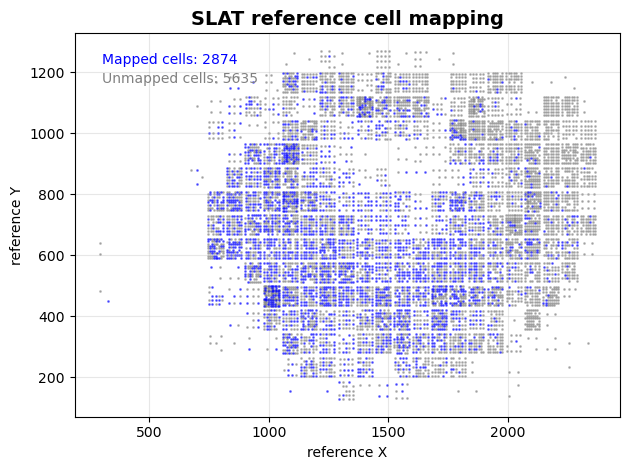

In [26]:
plt.scatter(
    ref_coords.loc[unused_ref_cells, 'x'],
    ref_coords.loc[unused_ref_cells, 'y'],
    s=1,
    c='gray',
    alpha=0.5,
)
plt.scatter(
    ref_coords.loc[used_ref_cells, 'x'],
    ref_coords.loc[used_ref_cells, 'y'],
    s=1,
    c='blue',
    alpha=0.5,
)
# Add labels for the number of cells mapped
plt.text(
    0.05, 0.95, 
    f'Mapped cells: {len(used_ref_cells)}', 
    transform=plt.gca().transAxes, 
    fontsize=10, 
    color='blue', 
    verticalalignment='top'
)
plt.text(
    0.05, 0.90, 
    f'Unmapped cells: {len(unused_ref_cells)}', 
    transform=plt.gca().transAxes, 
    fontsize=10, 
    color='gray', 
    verticalalignment='top'
)

# Add title and axis labels
plt.title(f'{matching_method} reference cell mapping', fontsize=14, fontweight='bold')
plt.xlabel('reference X', fontsize=10)
plt.ylabel('reference Y', fontsize=10)

# Improve aesthetics
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()
